# Data cleaning and Curation using Cleanvision

In [346]:
pip install torch torchvision tensorflow fastdup cleanvision matplotlib seaborn onnx onnxruntime albumentations scikit-learn


ERROR: Could not find a version that satisfies the requirement fastdup (from versions: none)
ERROR: No matching distribution found for fastdup


## Images distribution per class

Counts of images for each class: [448, 263, 213, 117, 97, 12, 387, 245, 24, 81, 481, 351]
Total number of images: 2719
Percentages of images for each class: ['16.48%', '9.67%', '7.83%', '4.30%', '3.57%', '0.44%', '14.23%', '9.01%', '0.88%', '2.98%', '17.69%', '12.91%']


C:\Users\Subham Gupta\AppData\Local\Temp\ipykernel_14712\3162426675.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[0].set_xticklabels(class_names, rotation=45)


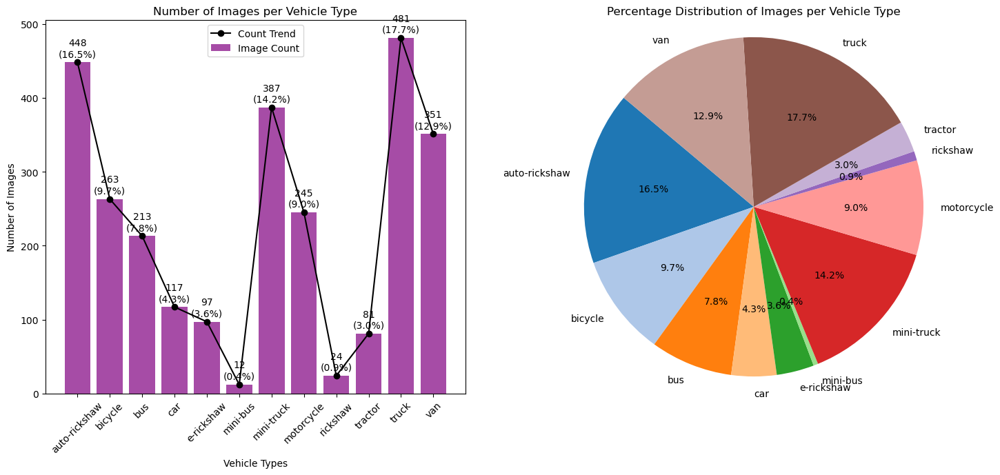

In [383]:
import matplotlib.pyplot as plt
import os

# Path to dataset
path = "original_vehicle_dataset/train"
class_names = sorted(os.listdir(path))

# Count images per class
NO_clean_arr = [len(os.listdir(os.path.join(path, class_name))) for class_name in class_names]
total_images = sum(NO_clean_arr)
percentages = [(count / total_images) * 100 for count in NO_clean_arr]

print("Counts of images for each class:", NO_clean_arr)
print("Total number of images:", total_images)
print("Percentages of images for each class:", [f"{pct:.2f}%" for pct in percentages])

# Combined visualization
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

# Bar plot
ax[0].bar(class_names, NO_clean_arr, color='purple', alpha=0.7, label="Image Count")
ax[0].plot(class_names, NO_clean_arr, color='black', marker='o', label="Count Trend")
ax[0].set_title('Number of Images per Vehicle Type')
ax[0].set_xlabel('Vehicle Types')
ax[0].set_ylabel('Number of Images')
ax[0].set_xticklabels(class_names, rotation=45)

# Annotate bar plot
for i, (count, pct) in enumerate(zip(NO_clean_arr, percentages)):
    ax[0].text(i, count + max(NO_clean_arr) * 0.01, f"{count}\n({pct:.1f}%)", 
               ha='center', va='bottom', fontsize=10)

ax[0].legend()

# Pie chart
ax[1].pie(percentages, labels=class_names, autopct='%1.1f%%', startangle=140, 
          colors=plt.cm.tab20.colors)
ax[1].set_title("Percentage Distribution of Images per Vehicle Type")
ax[1].axis('equal')  # Ensures the pie chart is circular

plt.tight_layout()
plt.show()



## Using Cleanvision for data curation

In [14]:
pip install cleanvision


In [384]:
from cleanvision.imagelab import Imagelab

# Initialize CleanVision
imagelab = Imagelab(data_path="original_vehicle_dataset/train")

# Detect issues
imagelab.find_issues()





Reading images from c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train
Checking for dark, light, odd_aspect_ratio, low_information, exact_duplicates, near_duplicates, blurry, grayscale, odd_size images ...


  0%|          | 0/2719 [00:00<?, ?it/s]

  0%|          | 0/2719 [00:00<?, ?it/s]

Issue checks completed. 141 issues found in the dataset. To see a detailed report of issues found, use imagelab.report().


In [385]:
issues = imagelab.issues
# Display the issues
issues


,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000028.jpg,0.391029,True,0.827357,False,0.901879,False,0.921931,False,1,False,0.871124,False,0.513743,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000029.jpg,0.442524,True,0.847482,False,0.906503,False,0.917402,False,1,False,0.874915,False,0.510420,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000041.jpg,0.771481,False,0.812821,False,0.890479,False,0.890781,False,1,False,0.866985,False,0.509935,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000074.jpg,0.771481,False,0.812821,False,0.895506,False,0.901353,False,1,False,0.864442,False,0.511727,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000131.jpg,0.712173,False,0.845103,False,0.882335,False,0.897619,False,1,False,0.842730,False,0.486228,False,1.0,False,1.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out06-30-08293.png,0.936321,False,0.611321,False,0.937135,False,0.908597,False,1,False,0.990773,False,0.593992,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-06152.png,0.920742,False,0.649635,False,0.941788,False,0.900454,False,1,False,0.990818,False,0.594459,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-06203.png,0.932699,False,0.630189,False,0.935827,False,0.879378,False,1,False,0.992530,False,0.597500,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-10166.png,0.920944,False,0.772908,False,0.928239,False,0.849415,False,1,False,0.944567,False,0.580622,False,1.0,False,1.0,False


In [386]:
issues['image_path'] = issues.index

In [387]:
issues

,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue,image_path
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000028.jpg,0.391029,True,0.827357,False,0.901879,False,0.921931,False,1,False,0.871124,False,0.513743,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000029.jpg,0.442524,True,0.847482,False,0.906503,False,0.917402,False,1,False,0.874915,False,0.510420,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000041.jpg,0.771481,False,0.812821,False,0.890479,False,0.890781,False,1,False,0.866985,False,0.509935,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000074.jpg,0.771481,False,0.812821,False,0.895506,False,0.901353,False,1,False,0.864442,False,0.511727,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000131.jpg,0.712173,False,0.845103,False,0.882335,False,0.897619,False,1,False,0.842730,False,0.486228,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out06-30-08293.png,0.936321,False,0.611321,False,0.937135,False,0.908597,False,1,False,0.990773,False,0.593992,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-06152.png,0.920742,False,0.649635,False,0.941788,False,0.900454,False,1,False,0.990818,False,0.594459,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-06203.png,0.932699,False,0.630189,False,0.935827,False,0.879378,False,1,False,0.992530,False,0.597500,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-10166.png,0.920944,False,0.772908,False,0.928239,False,0.849415,False,1,False,0.944567,False,0.580622,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...


Issues found in images in order of severity in the dataset

|    | issue_type       |   num_images |
|---:|:-----------------|-------------:|
|  0 | odd_aspect_ratio |           56 |
|  1 | near_duplicates  |           47 |
|  2 | odd_size         |           32 |
|  3 | blurry           |            6 |
|  4 | dark             |            0 |
|  5 | light            |            0 |
|  6 | low_information  |            0 |
|  7 | grayscale        |            0 |
|  8 | exact_duplicates |            0 | 

----------------- odd_aspect_ratio images ------------------

Number of examples with this issue: 56
Examples representing most severe instances of this issue:



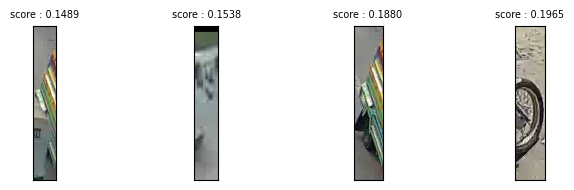

------------------ near_duplicates images ------------------

Number of examples with this issue: 47
Examples representing most severe instances of this issue:

Set: 0


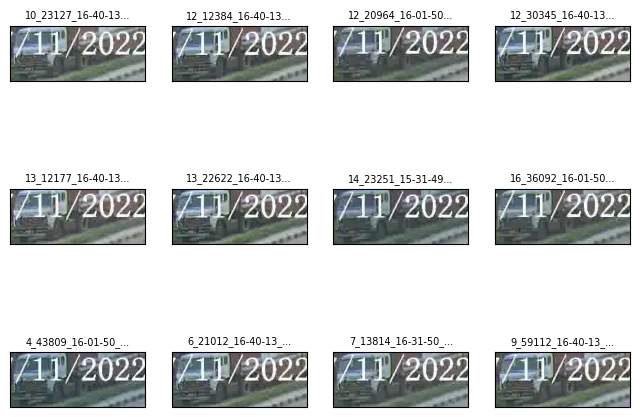

Set: 1


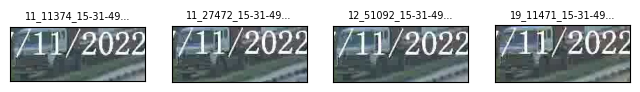

Set: 2


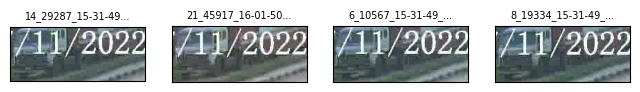

Set: 3


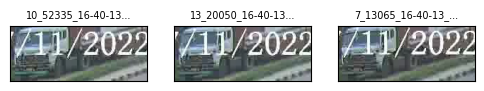

--------------------- odd_size images ----------------------

Number of examples with this issue: 32
Examples representing most severe instances of this issue:



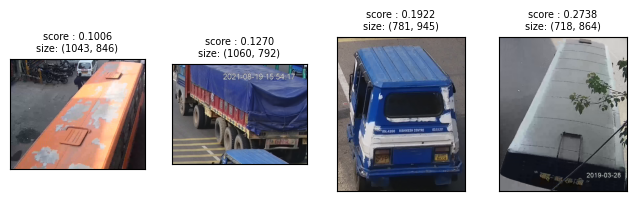

---------------------- blurry images -----------------------

Number of examples with this issue: 6
Examples representing most severe instances of this issue:



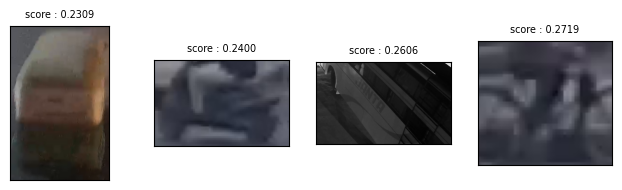

In [388]:
imagelab.report() # Display issues


In [389]:
# issues
# issues.to_csv("issues.csv", index=False)  # Save issues to a CSV file

In [390]:
imagelab.issue_summary

,issue_type,num_images
0,odd_aspect_ratio,56
1,near_duplicates,47
2,odd_size,32
3,blurry,6
4,dark,0
5,light,0
6,low_information,0
7,grayscale,0
8,exact_duplicates,0


## Only taking those firlds which has issues like ["odd_aspect_ratio"= 56, "near_duplicates" =	47, "odd_size"	= 32, "blurry" = 6]

### Blurry Images

Number of odd size images: 6


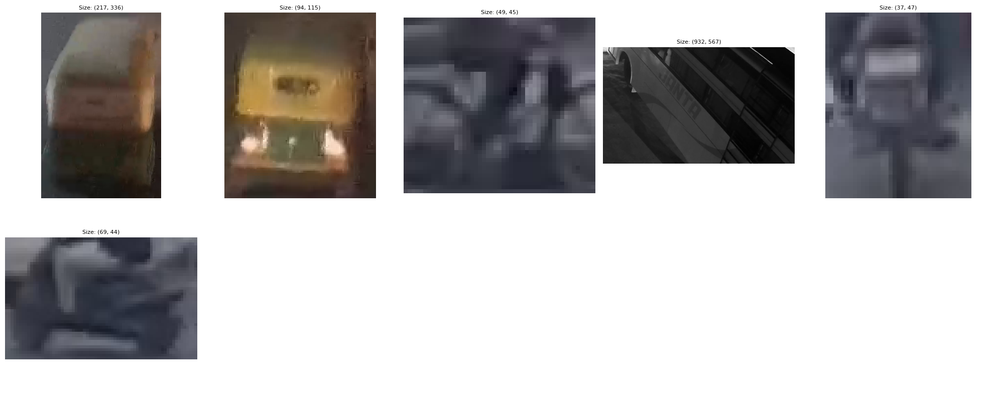

In [391]:
import matplotlib.pyplot as plt
from PIL import Image
import math

is_blurry_issue_issues = issues[issues['is_blurry_issue'] == True]
image_paths = is_blurry_issue_issues['image_path'].tolist()
print(f"Number of odd size images: {len(image_paths)}")

num_images = len(image_paths)
cols = 5  # Number of columns in the grid
rows = math.ceil(num_images / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
axes = axes.flatten()

for i, image_path in enumerate(image_paths):
    try:
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Size: {img.size}", fontsize=8)
    except Exception as e:
        axes[i].text(0.5, 0.5, f"Error\n{str(e)}", ha='center', va='center', fontsize=8)
        axes[i].axis('off')

# Hide any extra subplots if images are less than rows*cols
for j in range(num_images, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


### Odd Size

Number of odd size images: 32


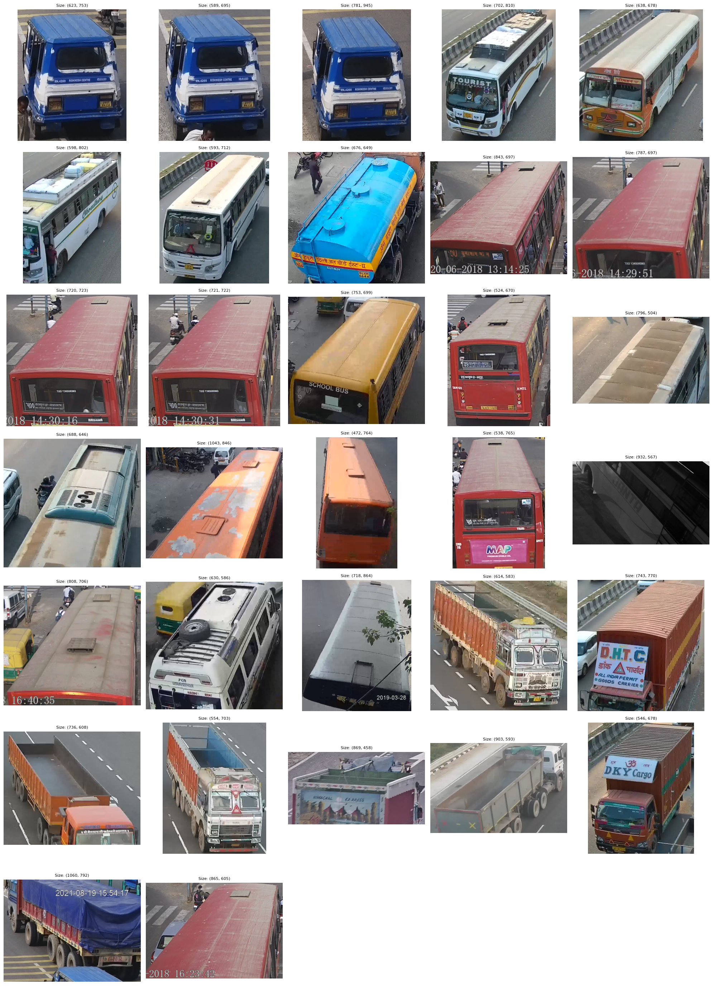

In [392]:
import matplotlib.pyplot as plt
from PIL import Image
import math

odd_size_issues = issues[issues['is_odd_size_issue'] == True]
image_paths = odd_size_issues['image_path'].tolist()
print(f"Number of odd size images: {len(image_paths)}")

num_images = len(image_paths)
cols = 5  # Number of columns in the grid
rows = math.ceil(num_images / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
axes = axes.flatten()

for i, image_path in enumerate(image_paths):
    try:
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Size: {img.size}", fontsize=8)
    except Exception as e:
        axes[i].text(0.5, 0.5, f"Error\n{str(e)}", ha='center', va='center', fontsize=8)
        axes[i].axis('off')

# Hide any extra subplots if images are less than rows*cols
for j in range(num_images, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()



## Near Duplicates

Number of odd size images: 47


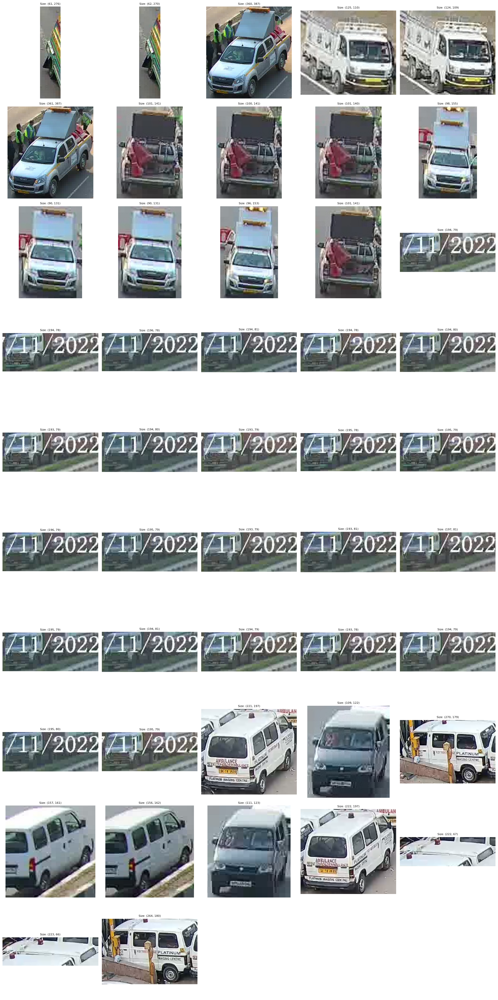

In [393]:
import matplotlib.pyplot as plt
from PIL import Image
import math

near_duplicates_issues = issues[issues['is_near_duplicates_issue'] == True]
image_paths = near_duplicates_issues['image_path'].tolist()
print(f"Number of odd size images: {len(image_paths)}")

num_images = len(image_paths)
cols = 5  # Number of columns in the grid
rows = math.ceil(num_images / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
axes = axes.flatten()

for i, image_path in enumerate(image_paths):
    try:
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Size: {img.size}", fontsize=8)
    except Exception as e:
        axes[i].text(0.5, 0.5, f"Error\n{str(e)}", ha='center', va='center', fontsize=8)
        axes[i].axis('off')

# Hide any extra subplots if images are less than rows*cols
for j in range(num_images, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


## Odd_Aspect ratio images

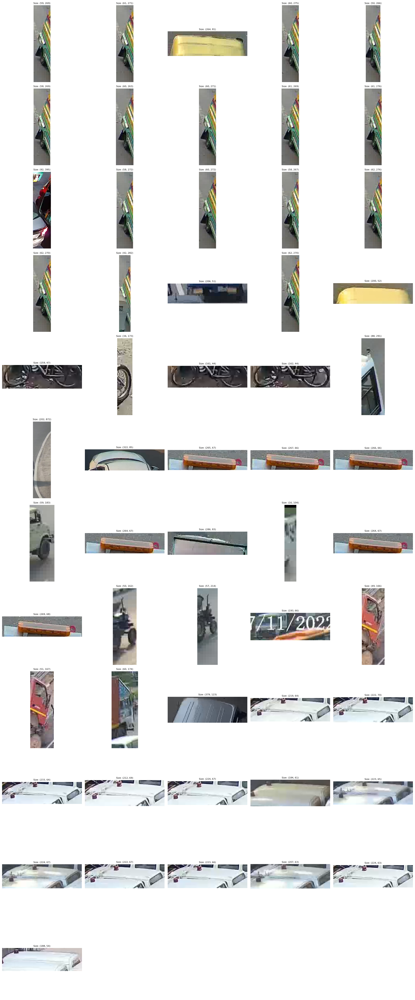

In [394]:
import matplotlib.pyplot as plt
from PIL import Image
import math

odd_sizeodd_aspect_issues_issues = issues[issues['is_odd_aspect_ratio_issue'] == True]
image_paths = odd_aspect_issues['image_path'].tolist()

num_images = len(image_paths)
cols = 5  # Number of columns in the grid
rows = math.ceil(num_images / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
axes = axes.flatten()

for i, image_path in enumerate(image_paths):
    try:
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Size: {img.size}", fontsize=8)
    except Exception as e:
        axes[i].text(0.5, 0.5, f"Error\n{str(e)}", ha='center', va='center', fontsize=8)
        axes[i].axis('off')

# Hide any extra subplots if images are less than rows*cols
for j in range(num_images, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()



## **Seeing these images its better to remove ["odd_aspect_ratio = 56, near_duplicates = 47 , blurry = 6]**

In [395]:
import os


cols = ["is_blurry_issue", "is_near_duplicates_issue", "is_odd_aspect_ratio_issue" ]  # list of boolean columns to check

# Keep track of deleted files to avoid double counting
deleted_files = set()

# Delete images where any of the columns is True
rows_to_delete = issues[issues[cols].any(axis=1)]

for image_path in rows_to_delete['image_path']:
    try:
        if os.path.exists(image_path):
            os.remove(image_path)
            deleted_files.add(image_path)
            print(f"Deleted: {image_path}")
        else:
            print(f"File not found (already removed?): {image_path}")
    except Exception as e:
        print(f"Error deleting {image_path}: {e}")

print("\nNumber of images deleted per column:")

for col in cols:
    # Count how many deleted images had this column True
    count = issues.loc[
        (issues[col] == True) & 
        (issues['image_path'].isin(deleted_files)),
        'image_path'
    ].nunique()
    print(f"{col}: {count}")


Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_2out01-30-0343.png
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/10_4623_15-31-49_031942.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/12_23628_15-31-49_031722.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/13_2261_15-31-49_010760.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/14_1278_15-31-49_032602.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/14_25219_15-31-49_029239.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/15_28871_15-31-49_030523.jpg
Deleted: c:/Users/Subham Gupta/

## After Remove the images with Valid Issues

In [396]:
from cleanvision.imagelab import Imagelab

# Initialize CleanVision
imagelab = Imagelab(data_path="original_vehicle_dataset/train")

# Detect issues
imagelab.find_issues()



Reading images from c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train
Checking for dark, light, odd_aspect_ratio, low_information, exact_duplicates, near_duplicates, blurry, grayscale, odd_size images ...


  0%|          | 0/2614 [00:00<?, ?it/s]

  0%|          | 0/2614 [00:00<?, ?it/s]

Issue checks completed. 27 issues found in the dataset. To see a detailed report of issues found, use imagelab.report().


In [397]:
imagelab.issue_summary

,issue_type,num_images
0,odd_size,27
1,dark,0
2,light,0
3,odd_aspect_ratio,0
4,low_information,0
5,blurry,0
6,grayscale,0
7,exact_duplicates,0
8,near_duplicates,0


In [398]:
no_issues = imagelab.issues
no_issues

,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000028.jpg,0.415177,True,0.827357,False,0.901879,False,0.921931,False,1,False,0.871124,False,0.513743,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000029.jpg,0.464760,True,0.847482,False,0.906503,False,0.917402,False,1,False,0.874915,False,0.510420,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000041.jpg,0.781504,False,0.812821,False,0.890479,False,0.890781,False,1,False,0.866985,False,0.509935,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000074.jpg,0.781504,False,0.812821,False,0.895506,False,0.901353,False,1,False,0.864442,False,0.511727,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/auto-rickshaw/0_00000131.jpg,0.724398,False,0.845103,False,0.882335,False,0.897619,False,1,False,0.842730,False,0.486228,False,1.0,False,1.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out06-30-08293.png,0.940223,False,0.611321,False,0.937135,False,0.908597,False,1,False,0.990773,False,0.593992,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-06152.png,0.925223,False,0.649635,False,0.941788,False,0.900454,False,1,False,0.990818,False,0.594459,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-06203.png,0.936736,False,0.630189,False,0.935827,False,0.879378,False,1,False,0.992530,False,0.597500,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train/van/9_2out07-00-10166.png,0.925418,False,0.772908,False,0.928239,False,0.849415,False,1,False,0.944567,False,0.580622,False,1.0,False,1.0,False


# Count of Images after Cleaning

Counts of images for each class: [444, 262, 212, 117, 97, 12, 375, 243, 24, 81, 458, 341]
Total number of images: 2666
Percentages of images for each class: ['16.65%', '9.83%', '7.95%', '4.39%', '3.64%', '0.45%', '14.07%', '9.11%', '0.90%', '3.04%', '17.18%', '12.79%']


C:\Users\Subham Gupta\AppData\Local\Temp\ipykernel_14712\2450022273.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[0].set_xticklabels(class_names, rotation=45)


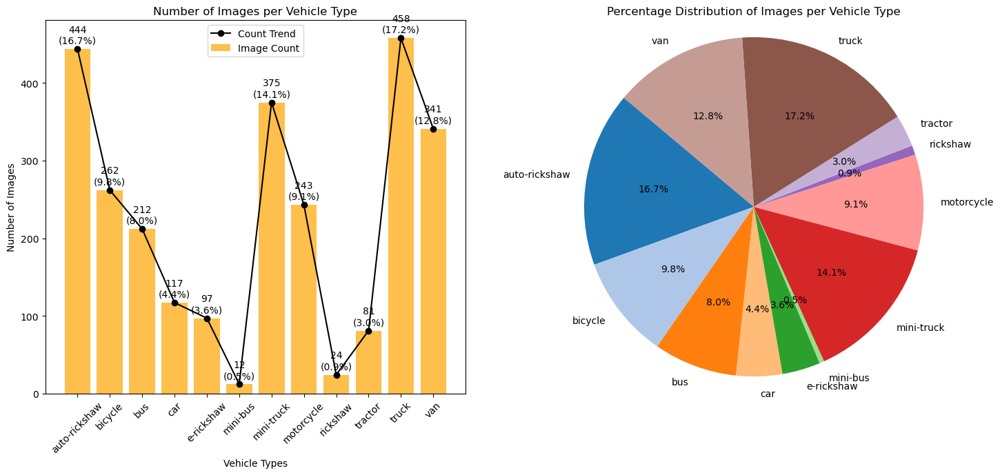

In [417]:
import matplotlib.pyplot as plt
import os

# Path to dataset
path = "vehicle_dataset/train"
class_names = sorted(os.listdir(path))

# Count images per class
clean_arr = [len(os.listdir(os.path.join(path, class_name))) for class_name in class_names]
total_images = sum(clean_arr)
percentages = [(count / total_images) * 100 for count in clean_arr]

print("Counts of images for each class:", clean_arr)
print("Total number of images:", total_images)
print("Percentages of images for each class:", [f"{pct:.2f}%" for pct in percentages])

# Combined visualization
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

# Bar plot
ax[0].bar(class_names, clean_arr, color='orange', alpha=0.7, label="Image Count")
ax[0].plot(class_names, clean_arr, color='black', marker='o', label="Count Trend")
ax[0].set_title('Number of Images per Vehicle Type')
ax[0].set_xlabel('Vehicle Types')
ax[0].set_ylabel('Number of Images')
ax[0].set_xticklabels(class_names, rotation=45)

# Annotate bar plot
for i, (count, pct) in enumerate(zip(clean_arr, percentages)):
    ax[0].text(i, count + max(clean_arr) * 0.01, f"{count}\n({pct:.1f}%)", 
               ha='center', va='bottom', fontsize=10)

ax[0].legend()

# Pie chart
ax[1].pie(percentages, labels=class_names, autopct='%1.1f%%', startangle=140, 
          colors=plt.cm.tab20.colors)
ax[1].set_title("Percentage Distribution of Images per Vehicle Type")
ax[1].axis('equal')  # Ensures the pie chart is circular

plt.tight_layout()
plt.show()


# Doing similar stuff for VALIDATION SET

Counts of images for each class: [137, 69, 71, 35, 6, 1, 102, 69, 12, 3, 157, 103]
Total number of images: 765
Percentages of images for each class: ['17.91%', '9.02%', '9.28%', '4.58%', '0.78%', '0.13%', '13.33%', '9.02%', '1.57%', '0.39%', '20.52%', '13.46%']


C:\Users\Subham Gupta\AppData\Local\Temp\ipykernel_14712\1293614075.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[0].set_xticklabels(class_names, rotation=45)


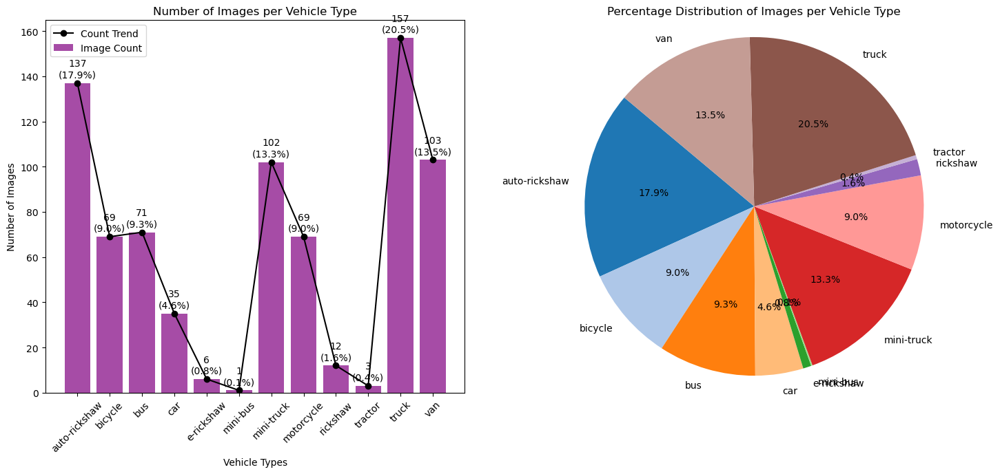

In [401]:
import matplotlib.pyplot as plt
import os

# Path to dataset
path = "original_vehicle_dataset/val"
class_names = sorted(os.listdir(path))

# Count images per class
NO_clean_arr = [len(os.listdir(os.path.join(path, class_name))) for class_name in class_names]
total_images = sum(NO_clean_arr)
percentages = [(count / total_images) * 100 for count in NO_clean_arr]

print("Counts of images for each class:", NO_clean_arr)
print("Total number of images:", total_images)
print("Percentages of images for each class:", [f"{pct:.2f}%" for pct in percentages])

# Combined visualization
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

# Bar plot
ax[0].bar(class_names, NO_clean_arr, color='purple', alpha=0.7, label="Image Count")
ax[0].plot(class_names, NO_clean_arr, color='black', marker='o', label="Count Trend")
ax[0].set_title('Number of Images per Vehicle Type')
ax[0].set_xlabel('Vehicle Types')
ax[0].set_ylabel('Number of Images')
ax[0].set_xticklabels(class_names, rotation=45)

# Annotate bar plot
for i, (count, pct) in enumerate(zip(NO_clean_arr, percentages)):
    ax[0].text(i, count + max(NO_clean_arr) * 0.01, f"{count}\n({pct:.1f}%)", 
               ha='center', va='bottom', fontsize=10)

ax[0].legend()

# Pie chart
ax[1].pie(percentages, labels=class_names, autopct='%1.1f%%', startangle=140, 
          colors=plt.cm.tab20.colors)
ax[1].set_title("Percentage Distribution of Images per Vehicle Type")
ax[1].axis('equal')  # Ensures the pie chart is circular

plt.tight_layout()
plt.show()



In [402]:
from cleanvision.imagelab import Imagelab

# Initialize CleanVision
imagelab = Imagelab(data_path="original_vehicle_dataset/val")

# Detect issues
imagelab.find_issues()

issues = imagelab.issues
# Display the issues
issues


Reading images from c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val
Checking for dark, light, odd_aspect_ratio, low_information, exact_duplicates, near_duplicates, blurry, grayscale, odd_size images ...


  0%|          | 0/765 [00:00<?, ?it/s]

  0%|          | 0/765 [00:00<?, ?it/s]

Issue checks completed. 34 issues found in the dataset. To see a detailed report of issues found, use imagelab.report().


,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_00000057.jpg,0.764929,False,0.997475,False,0.895252,False,0.903104,False,1,False,0.829932,False,0.491426,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_1271_16-40-13_003304.jpg,0.975812,False,0.798701,False,0.912567,False,0.881882,False,1,False,0.976383,False,0.546690,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_14533_16-40-13_020234.jpg,0.939129,False,0.845455,False,0.907139,False,0.856420,False,1,False,0.878243,False,0.525353,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_2out06-30-0886.png,0.959458,False,0.720280,False,0.895328,False,0.794399,False,1,False,0.879935,False,0.488491,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_48798_14-31-49_031221.jpg,0.911075,False,0.626582,False,0.901968,False,0.915369,False,1,False,0.975095,False,0.495446,False,1.0,False,1.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/van/9_10626_16-40-13_016301.jpg,0.998403,False,0.808989,False,0.908240,False,0.875982,False,1,False,0.999056,False,0.526133,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/van/9_13666_16-40-13_006278.jpg,0.941750,False,0.786325,False,0.904376,False,0.821074,False,1,False,0.990807,False,0.472237,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/van/9_17858_10-21-08_009794.jpg,0.822061,False,0.837838,False,0.917675,False,0.881742,False,1,False,0.978554,False,0.441713,False,1.0,False,1.0,False
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/van/9_45005_14-31-49_019391.jpg,0.994536,False,0.773684,False,0.913236,False,0.898986,False,1,False,0.842187,False,0.511863,False,1.0,False,1.0,False


Issues found in images in order of severity in the dataset

|    | issue_type       |   num_images |
|---:|:-----------------|-------------:|
|  0 | odd_aspect_ratio |           23 |
|  1 | odd_size         |            7 |
|  2 | near_duplicates  |            4 |
|  3 | dark             |            0 |
|  4 | light            |            0 |
|  5 | low_information  |            0 |
|  6 | blurry           |            0 |
|  7 | grayscale        |            0 |
|  8 | exact_duplicates |            0 | 

----------------- odd_aspect_ratio images ------------------

Number of examples with this issue: 23
Examples representing most severe instances of this issue:



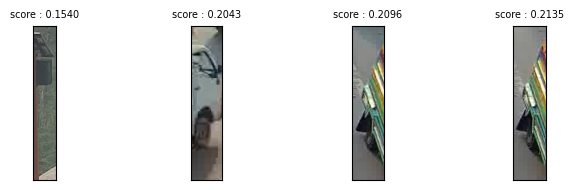

--------------------- odd_size images ----------------------

Number of examples with this issue: 7
Examples representing most severe instances of this issue:



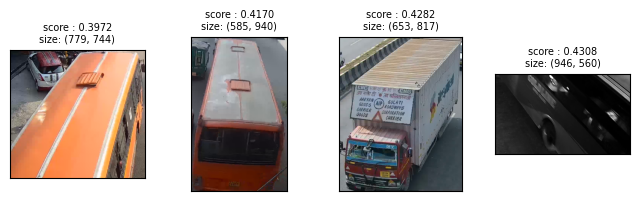

------------------ near_duplicates images ------------------

Number of examples with this issue: 4
Examples representing most severe instances of this issue:

Set: 0


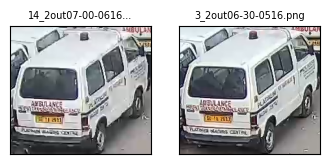

Set: 1


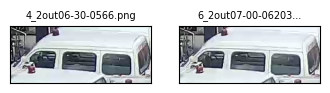

,issue_type,num_images
0,odd_aspect_ratio,23
1,odd_size,7
2,near_duplicates,4
3,dark,0
4,light,0
5,low_information,0
6,blurry,0
7,grayscale,0
8,exact_duplicates,0


In [403]:
issues['image_path'] = issues.index

imagelab.report() # Display issues

imagelab.issue_summary

# Visualizing all 3 types of issues 

Number of odd aspect ratio images: 23


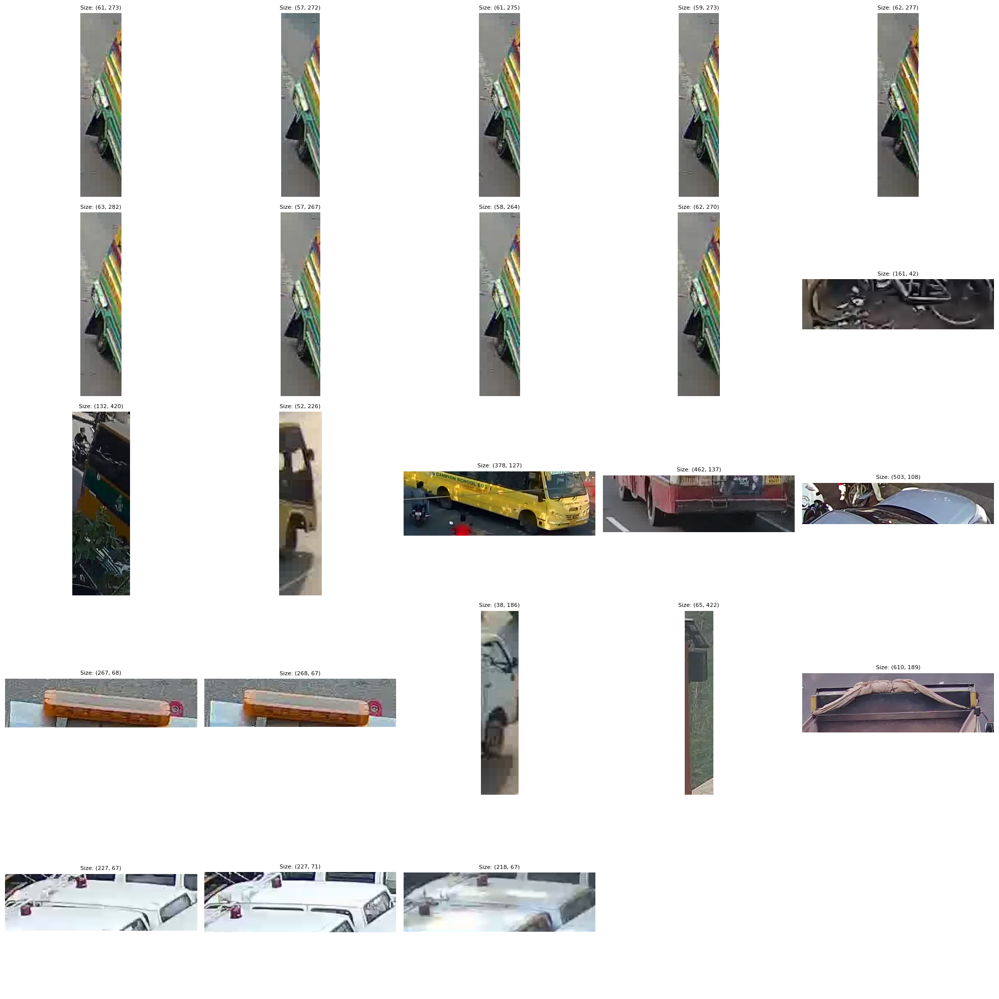

In [404]:

import matplotlib.pyplot as plt
from PIL import Image
import math

is_odd_aspect_ratio_issues = issues[issues['is_odd_aspect_ratio_issue'] == True]
image_paths = is_odd_aspect_ratio_issues['image_path'].tolist()
print(f"Number of odd aspect ratio images: {len(image_paths)}")

num_images = len(image_paths)
cols = 5  # Number of columns in the grid
rows = math.ceil(num_images / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
axes = axes.flatten()

for i, image_path in enumerate(image_paths):
    try:
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Size: {img.size}", fontsize=8)
    except Exception as e:
        axes[i].text(0.5, 0.5, f"Error\n{str(e)}", ha='center', va='center', fontsize=8)
        axes[i].axis('off')

# Hide any extra subplots if images are less than rows*cols
for j in range(num_images, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

In [405]:
issues

,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue,image_path
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_00000057.jpg,0.764929,False,0.997475,False,0.895252,False,0.903104,False,1,False,0.829932,False,0.491426,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_1271_16-40-13_003304.jpg,0.975812,False,0.798701,False,0.912567,False,0.881882,False,1,False,0.976383,False,0.546690,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_14533_16-40-13_020234.jpg,0.939129,False,0.845455,False,0.907139,False,0.856420,False,1,False,0.878243,False,0.525353,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_2out06-30-0886.png,0.959458,False,0.720280,False,0.895328,False,0.794399,False,1,False,0.879935,False,0.488491,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/0_48798_14-31-49_031221.jpg,0.911075,False,0.626582,False,0.901968,False,0.915369,False,1,False,0.975095,False,0.495446,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/van/9_10626_16-40-13_016301.jpg,0.998403,False,0.808989,False,0.908240,False,0.875982,False,1,False,0.999056,False,0.526133,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/van/9_13666_16-40-13_006278.jpg,0.941750,False,0.786325,False,0.904376,False,0.821074,False,1,False,0.990807,False,0.472237,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/van/9_17858_10-21-08_009794.jpg,0.822061,False,0.837838,False,0.917675,False,0.881742,False,1,False,0.978554,False,0.441713,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...
c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/van/9_45005_14-31-49_019391.jpg,0.994536,False,0.773684,False,0.913236,False,0.898986,False,1,False,0.842187,False,0.511863,False,1.0,False,1.0,False,c:/Users/Subham Gupta/Desktop/Work/i2v_system_...


## near duplicates

Number of odd size images: 4


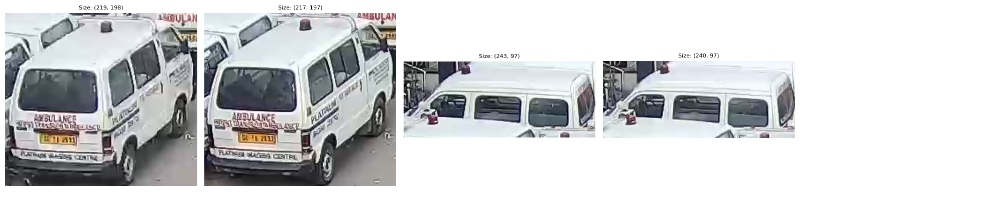

In [406]:
import matplotlib.pyplot as plt
from PIL import Image
import math

near_duplicates_issues = issues[issues['is_near_duplicates_issue'] == True]
image_paths = near_duplicates_issues['image_path'].tolist()
print(f"Number of odd size images: {len(image_paths)}")

num_images = len(image_paths)
cols = 5  # Number of columns in the grid
rows = math.ceil(num_images / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
axes = axes.flatten()

for i, image_path in enumerate(image_paths):
    try:
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Size: {img.size}", fontsize=8)
    except Exception as e:
        axes[i].text(0.5, 0.5, f"Error\n{str(e)}", ha='center', va='center', fontsize=8)
        axes[i].axis('off')

# Hide any extra subplots if images are less than rows*cols
for j in range(num_images, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


## Odd size

Number of odd size images: 7


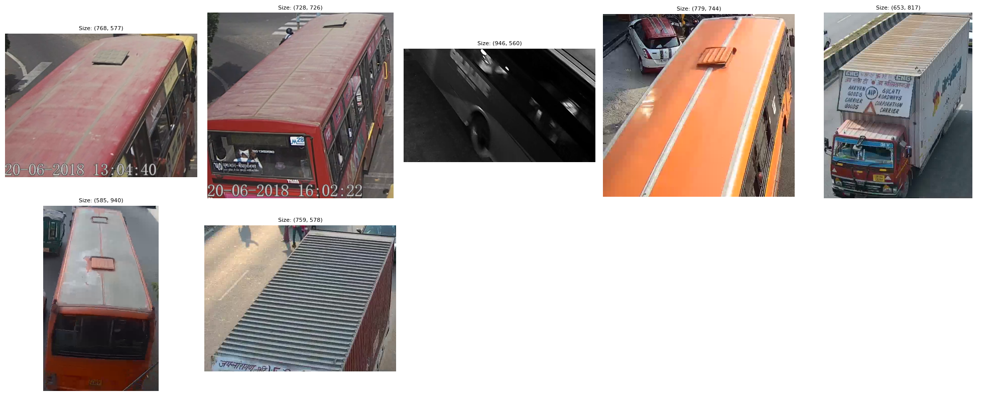

In [407]:
import matplotlib.pyplot as plt
from PIL import Image
import math

odd_size_issues = issues[issues['is_odd_size_issue'] == True]
image_paths = odd_size_issues['image_path'].tolist()
print(f"Number of odd size images: {len(image_paths)}")

num_images = len(image_paths)
cols = 5  # Number of columns in the grid
rows = math.ceil(num_images / cols)

fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
axes = axes.flatten()

for i, image_path in enumerate(image_paths):
    try:
        img = Image.open(image_path)
        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(f"Size: {img.size}", fontsize=8)
    except Exception as e:
        axes[i].text(0.5, 0.5, f"Error\n{str(e)}", ha='center', va='center', fontsize=8)
        axes[i].axis('off')

# Hide any extra subplots if images are less than rows*cols
for j in range(num_images, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()



## Removing odd aspect ratio images 

In [408]:
import os


cols = ["is_near_duplicates_issue", "is_odd_aspect_ratio_issue" ]  # list of boolean columns to check

# Keep track of deleted files to avoid double counting
deleted_files = set()

# Delete images where any of the columns is True
rows_to_delete = issues[issues[cols].any(axis=1)]

for image_path in rows_to_delete['image_path']:
    try:
        if os.path.exists(image_path):
            os.remove(image_path)
            deleted_files.add(image_path)
            print(f"Deleted: {image_path}")
        else:
            print(f"File not found (already removed?): {image_path}")
    except Exception as e:
        print(f"Error deleting {image_path}: {e}")

print("\nNumber of images deleted per column:")

for col in cols:
    # Count how many deleted images had this column True
    count = issues.loc[
        (issues[col] == True) & 
        (issues['image_path'].isin(deleted_files)),
        'image_path'
    ].nunique()
    print(f"{col}: {count}")


Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/12_19171_15-31-49_031595.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/12_30857_15-31-49_029144.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/12_43149_15-31-49_032590.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/14_13398_15-31-49_029856.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/18_23291_15-31-49_029036.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/18_45774_15-31-49_028951.jpg
Deleted: c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/val/auto-rickshaw/21_43563_15-31-49_029507.jpg
Deleted: c:/Users/Subham Gupta/Des

In [421]:
from cleanvision.imagelab import Imagelab

# Initialize CleanVision
imagelab = Imagelab(data_path="original_vehicle_dataset/train")

# Detect issues
imagelab.find_issues()

# issues = imagelab.issues
# # Display the issues
# issues

Reading images from c:/Users/Subham Gupta/Desktop/Work/i2v_system_Visiontask/original_vehicle_dataset/train
Checking for dark, light, odd_aspect_ratio, low_information, exact_duplicates, near_duplicates, blurry, grayscale, odd_size images ...


  0%|          | 0/2614 [00:00<?, ?it/s]

  0%|          | 0/2614 [00:00<?, ?it/s]

Issue checks completed. 27 issues found in the dataset. To see a detailed report of issues found, use imagelab.report().


In [422]:
imagelab.issue_summary

,issue_type,num_images
0,odd_size,27
1,dark,0
2,light,0
3,odd_aspect_ratio,0
4,low_information,0
5,blurry,0
6,grayscale,0
7,exact_duplicates,0
8,near_duplicates,0


#### After cleaning the image ..we can see above the images have been removed